**CLASS LABELS ARE OPPOSITE OF SUBMISSION!! CORRECT BEFORE SUBMMITTING**

**TO DO**


- ~~Split dataset into train and eval and solve class imabalance~~
- ~~Add eval code to train loop ! SOMETHING WRONG HERE~~
- Check for appropriate resize value in transforms
- Add code to save checkpoints of the model
- ~~Generate labels for unlabeled dataset~~
---

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Setup and imports

In [2]:
%load_ext tensorboard
import torchvision
from torchvision import transforms as T
import torch
import torch.nn as nn
import numpy as np
import pandas as pd
from tqdm.auto import tqdm 
from IPython.display import Image 
import os
from skimage import io
import time
from sklearn.model_selection import train_test_split
from collections import Counter
import copy
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, f1_score
from torch.utils.tensorboard import SummaryWriter
from skimage.transform import resize as io_resize
import cv2
import json
import datetime

# Dataset and loader

In [3]:
!echo Validation data $(ls "/content/drive/MyDrive/FloodNet Challenge @ EARTHVISION 2021 - Track 1/Validation/image" | wc -l)

Validation data 450


In [4]:
%%capture unzip_out
%cp "/content/drive/MyDrive/dataset_fn.zip" .
!unzip -o dataset_fn.zip
%rm dataset_fn.zip

In [5]:
RESIZE=(400,300)
temp_root = "/content/drive/MyDrive/FloodNet Challenge @ EARTHVISION 2021 - Track 1" 
local_root = "/content/drive/MyDrive/FloodNet"
def resize_and_save(path, resize=RESIZE):
  for img_name in tqdm(os.listdir(os.path.join(temp_root, path))):
    img = cv2.imread(os.path.join(temp_root, path, img_name))
    img = cv2.resize(img, RESIZE)
    cv2.imwrite(os.path.join(local_root, path, img_name), img)

In [6]:
# %cp -r "/content/drive/MyDrive/FloodNet Challenge @ EARTHVISION 2021 - Track 1" "./FloodNet Challenge @ EARTHVISION 2021 - Track 1"
os.makedirs("/content/drive/MyDrive/FloodNet/Train/Labeled/Flooded/image", exist_ok=True)
os.makedirs("/content/drive/MyDrive/FloodNet/Train/Labeled/Non-Flooded/image", exist_ok=True)
os.makedirs("/content/drive/MyDrive/FloodNet/Train/Unlabeled/image", exist_ok=True)

In [ ]:
resize_and_save("Train/Labeled/Flooded/image")
resize_and_save("Train/Labeled/Non-Flooded/image")
resize_and_save("Train/Unlabeled/image")

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/347 [00:00<?, ?it/s]

In [10]:
%%bash
echo Flooded Samples: $(ls "/content/drive/MyDrive/FloodNet/Train/Labeled/Flooded/image" | wc -l)
echo Non-Flooded Samples: $(ls "/content/drive/MyDrive/FloodNet/Train/Labeled/Non-Flooded/image" | wc -l)

Flooded Samples: 0
Non-Flooded Samples: 0


In [ ]:
class T1Dataset(torch.utils.data.Dataset):
  """
  This is to use with array of files and array of labels as an input
  """
  def __init__(self, X, y, transform=None):
    self.X = X
    self.y = y
    self.transform = transform

  def __len__(self):
    return len(self.X)
  
  def __getitem__(self, idx):
    image = io.imread(self.X[idx])
    if self.transform is not None:
      image = self.transform(image)
    if self.y is None:
      return (image, idx)
    return (image, self.y[idx])

In [ ]:
transforms = { 
'train' : T.Compose([
                      T.ToPILImage(),
                      # T.RandomResizedCrop(3000),
                      T.RandomHorizontalFlip(),
                      T.RandomVerticalFlip(),
                      # T.Resize((512,512)),
                      T.ToTensor(),
                      T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
        ]),
'valid' : T.Compose([
                     T.ToPILImage(),
                    #  T.CenterCrop(3000),
                    #  T.Resize(500),
                     T.ToTensor(),
                     T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        ])
}

In [ ]:
flooded_root = '/content/FloodNet Challenge @ EARTHVISION 2021 - Track 1/Train/Labeled/Flooded/image/'
flooded_files = [flooded_root+name for name in os.listdir(flooded_root)]
flooded_y = [1]*len(flooded_files)

In [ ]:
non_flooded_root = '/content/FloodNet Challenge @ EARTHVISION 2021 - Track 1/Train/Labeled/Non-Flooded/image/'
non_flooded_files = [non_flooded_root+name for name in os.listdir(non_flooded_root)]
non_flooded_y = [0]*len(non_flooded_files)

In [ ]:
X = flooded_files+non_flooded_files
y = flooded_y+non_flooded_y
print(len(X), len(y))

398 398


In [ ]:
# X_train = X
# y_train = y

In [ ]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y, train_size=0.5, stratify=y)
print(len(X_train), Counter(y_train), len(X_valid), Counter(y_valid))

398 Counter({0: 347, 1: 51}) 199 Counter({0: 174, 1: 25})


In [ ]:
BATCH_SIZE = 64

unique_labels, counts = np.unique(y_train, return_counts=True)
class_weights = [1/c for c in counts]
# class_weights[1]*=1.5 # SKEWING THE SAMPLER MORE
sample_weights = [0] * len(y_train)
for idx, lbl in enumerate(y_train):
  sample_weights[idx] = class_weights[lbl]
print(sample_weights)
sampler_train = torch.utils.data.WeightedRandomSampler(weights=sample_weights, num_samples=len(sample_weights), replacement=True)


train_set = T1Dataset(X_train, y_train, transform=transforms['train'])
valid_set = T1Dataset(X_valid, y_valid, transform=transforms['valid'])

dataloaders = {
    'train': torch.utils.data.DataLoader(train_set, batch_size=BATCH_SIZE, sampler=sampler_train),
    'valid': torch.utils.data.DataLoader(valid_set, batch_size=BATCH_SIZE, shuffle=True)
}

[0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549, 0.0196078431372549,

In [ ]:
dataset_size = {
    'train':len(train_set),
    'valid':len(valid_set)
}
dataset_size

{'train': 398, 'valid': 199}

In [ ]:
print(len(dataloaders['train']), len(dataloaders['valid']))

7 4


In [ ]:
%%timeit
image, label = next(iter(dataloaders['train']))
print(image[0].shape)

torch.Size([3, 300, 400])
torch.Size([3, 300, 400])
torch.Size([3, 300, 400])
torch.Size([3, 300, 400])
torch.Size([3, 300, 400])
torch.Size([3, 300, 400])
1 loop, best of 5: 360 ms per loop


In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

# Semi supervised train stuff

In [ ]:
!echo Unlabelled samples: $(ls "/content/FloodNet Challenge @ EARTHVISION 2021 - Track 1/Train/Unlabeled/image" | wc -l)

Unlabelled samples: 1047


In [ ]:
unlabeled_root = "/content/FloodNet Challenge @ EARTHVISION 2021 - Track 1/Train/Unlabeled/image/"
unlabeled_file_names = os.listdir(unlabeled_root)
unlabeled_file_names = list(map(lambda x: unlabeled_root+x, unlabeled_file_names))

# Adding validation set to unlabeled data 
for ds in ['Validation', 'Test']:
  data_root_ = f"/content/FloodNet Challenge @ EARTHVISION 2021 - Track 1/{ds}/image/"
  data_file_names_ = os.listdir(data_root_)
  unlabeled_file_names += list(map(lambda x: data_root_+x, data_file_names_))

unlabeled_file_names.sort()
pseudo_labels = np.array([-1]*len(unlabeled_file_names))

unlabeled_ds = T1Dataset(unlabeled_file_names, None, transform=transforms['valid'])
unlabeled_loader = torch.utils.data.DataLoader(unlabeled_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=0)

dataloaders['unlabeled'] = unlabeled_loader

# next(iter(unlabeled_loader))[1]

*In case of an unlabeled data loader the* `__getitem()__` *returns **image** and its **idx** in the array.*

In [ ]:
def ss_train(model, criterion, optimizer, num_epochs, start_alpha_from=5, reach_max_alpha_in=15, max_alpha=1, scheduler=None):
  writer = SummaryWriter()
  alphas = np.linspace(0, max_alpha, reach_max_alpha_in-start_alpha_from)

  since = time.time()

  best_model_wts = copy.deepcopy(model.state_dict())
  best_f1 = 0.0

  for epoch in range(num_epochs):

    print('-'*80)
    if epoch < start_alpha_from:
      alpha = 0
    elif epoch-start_alpha_from >= len(alphas):
      alpha = alphas[-1]
    else:
      # alpha = ((start_alpha_from-max_alpha)/(reach_max_alpha_in-0))*epoch
      # alpha = ((max_alpha-0)/(reach_max_alpha_in-start_alpha_from))*epoch # Correct linearly alpha ramping equation
      alpha = alphas[max(0,epoch-start_alpha_from)]

    for phase in ['train', 'unlabeled', 'valid']:
      print(phase)
      print('-'*5)
      if alpha == 0 and phase == 'unlabeled':
        continue
      if phase in ['train', 'unlabeled']:
        model.train()
      else:
        model.eval()

      running_loss = 0.0
      running_corrects = 0

      # for confusion matrix
      epoch_preds = []
      epoch_lbls = []

      for batch_id, (img, lbl) in enumerate(tqdm(dataloaders[phase], desc=f"Epoch {epoch}/{num_epochs}, {phase}, alpha:{alpha:.2f}")):
        img = img.to(device)
        if phase in ['train', 'valid']:
          lbl = lbl.to(device)

        optimizer.zero_grad()

        with torch.set_grad_enabled(phase in ['train', 'unlabeled']):
          output = model(img)
          preds = torch.argmax(output, 1)
          
          if phase in ['train', 'valid']:
            loss = criterion(output, lbl)
          else:
            loss = alpha*criterion(output, torch.tensor(pseudo_labels[lbl], dtype=torch.int64).to(device))

          if phase in ['train', 'valid']:
            epoch_preds.extend(preds.detach().cpu())
            epoch_lbls.extend(lbl.detach().cpu())

          if phase in ['train', 'unlabeled']:
            loss.backward()
            optimizer.step()

        if phase in ['train', 'valid']:
          writer.add_scalars(f'Step-Loss/{phase}', {'loss':loss.item(), 'alpha':alpha}, (len(dataloaders[phase])*epoch)+batch_id)
          running_loss += loss.item() * img.size(0)
          running_corrects += torch.sum(preds == lbl.data)

      # if phase in ['train', 'valid']:
      #   print(confusion_matrix(epoch_lbls, epoch_preds), np.array([0, 1]))
      
      if scheduler is not None and phase == 'train':
        scheduler.step()

      if phase in ['train', 'valid']:
        epoch_f1 = f1_score(epoch_lbls, epoch_preds)
        epoch_loss = running_loss / dataset_size[phase]
        epoch_acc = running_corrects.double() / dataset_size[phase]

      if phase in ['train', 'valid']:
        writer.add_scalar(f'Loss/{phase}', epoch_loss, epoch)
        writer.add_scalars(f'F1/{phase}', {'f1':epoch_f1, 'alpha':alpha}, epoch)
        writer.add_scalars(f'Accuracy/{phase}', {'accu':epoch_acc, 'alpha':alpha}, epoch)

        print(f'Epoch {epoch}, {phase} Loss: {epoch_loss:.4f}, Acc:{epoch_acc:.4f}, F1:{epoch_f1:.4f}')
      
      if phase == 'train' and epoch >= start_alpha_from-1:
        model.eval()
        for img, lbl in tqdm(dataloaders['unlabeled'], desc="Predicting pseudo labels"):
          img = img.to(device)
          preds = torch.argmax(model(img), 1)
          pseudo_labels[lbl] = preds.detach().cpu()

      if phase == 'valid' and epoch_f1 > best_f1:
        best_epoch = epoch
        best_f1 = epoch_f1
        best_model_wts = copy.deepcopy(model.state_dict())
        torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
        }, f"/content/drive/MyDrive/checkpoints/best_ckpt.pt")
  
  time_elapsed = time.time() - since
  writer.close()
  current_time = datetime.datetime.now()
  torch.save({
        'epoch': num_epochs-1,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, f"/content/drive/MyDrive/checkpoints/fn_{num_epochs}_{current_time.day}_{current_time.hour}_{current_time.minute}_not_best.pt")
  print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
  print(f'Saved model is from {best_epoch} epoch with f1 {best_f1}')
  model.load_state_dict(best_model_wts)
  return (model, best_epoch)

In [ ]:
%rm -r runs *.json

rm: cannot remove 'runs': No such file or directory
rm: cannot remove '*.json': No such file or directory


In [ ]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

In [ ]:
def sexy_tuner():
  for lr in [0.01]:
    # model = torch.hub.load('facebookresearch/dino:main', 'dino_resnet50')
    model = torchvision.models.resnet18(pretrained=True)
    final_layer_in = model.fc.in_features
    model.fc = torch.nn.Linear(final_layer_in, 2)
    model = model.to(device)
    criterion = torch.nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr=lr)
    # optimizer = torch.optim.Adam(model.parameters())

    model, best_ep = ss_train(model, criterion, optimizer, 200, start_alpha_from=10, reach_max_alpha_in=150)
    current_time = datetime.datetime.now()
    torch.save({
        'epoch': best_ep,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, f"/content/drive/MyDrive/checkpoints/fn_{lr}_{best_ep}_{current_time.day}_{current_time.hour}_{current_time.minute}_best.pt")

    return (model, best_ep)

In [ ]:
%%capture train_stats
trained_model, b_e = sexy_tuner()

In [ ]:
# %mv runs/ /content/drive/MyDrive/

In [ ]:
# model, b_ep = ss_train(model, criterion, optimizer, 100)

# Generate validation results

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
MODE = "Test"
# MODE = "Validation"

In [ ]:
# model = torchvision.models.resnet18(pretrained=True)
# final_layer_in = model.fc.in_features
# model.fc = torch.nn.Linear(final_layer_in, 2)

# checkpt = torch.load('/content/drive/MyDrive/checkpoints/fn_0.01_130_11_18_17_best.pt', map_location=device)
# model.load_state_dict(checkpt['model_state_dict'])
# model = model.to(device)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


In [ ]:
model = trained_model

In [ ]:
# dataloaders = {}
validation_root = f"/content/FloodNet Challenge @ EARTHVISION 2021 - Track 1/{MODE}/image/"
validation_file_names = os.listdir(validation_root)
validation_file_names.sort()
validation_file_names = list(map(lambda x: validation_root+x, validation_file_names))

validation_ds = T1Dataset(validation_file_names, None, transform=transforms['valid'])
validation_loader = torch.utils.data.DataLoader(validation_ds, batch_size=BATCH_SIZE, shuffle=False)

dataloaders['validation_dataset'] = validation_loader

In [ ]:
model.eval()
json_data = {}
for img, lbl in tqdm(dataloaders['validation_dataset'], desc="Calculating result"):
  img = img.to(device)
  preds = torch.argmax(model(img),1)
  fnames = list(map(lambda x: os.path.splitext(os.path.split(validation_file_names[x])[1])[0], lbl))
  # save in json
  preds = preds.detach().tolist()
  preds = list(map(lambda x: x^1, preds)) # this is to invert 1s to 0s and 0s to 1s
  json_data.update(dict(zip(fnames, preds)))
with open(f'image_classes.json', 'w') as f:
    json.dump(json_data, f)

In [ ]:
from google.colab import files
files.download('image_classes.json')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
print(train_stats)


--------------------------------------------------------------------------------
train
-----

Epoch 0, train Loss: 0.7123, Acc:0.5628, F1:0.4971
unlabeled
-----
valid
-----

Epoch 0, valid Loss: 0.4747, Acc:0.9045, F1:0.6545
--------------------------------------------------------------------------------
train
-----

Epoch 1, train Loss: 0.4761, Acc:0.7638, F1:0.7892
unlabeled
-----
valid
-----

Epoch 1, valid Loss: 0.5542, Acc:0.7387, F1:0.4583
--------------------------------------------------------------------------------
train
-----

Epoch 2, train Loss: 0.3627, Acc:0.8442, F1:0.8360
unlabeled
-----
valid
-----

Epoch 2, valid Loss: 0.2091, Acc:0.9598, F1:0.8182
--------------------------------------------------------------------------------
train
-----

Epoch 3, train Loss: 0.3612, Acc:0.8291, F1:0.8090
unlabeled
-----
valid
-----

Epoch 3, valid Loss: 0.2596, Acc:0.9397, F1:0.7692
--------------------------------------------------------------------------------
train
-----

Epoch

# Check random samples

Not-Flooded


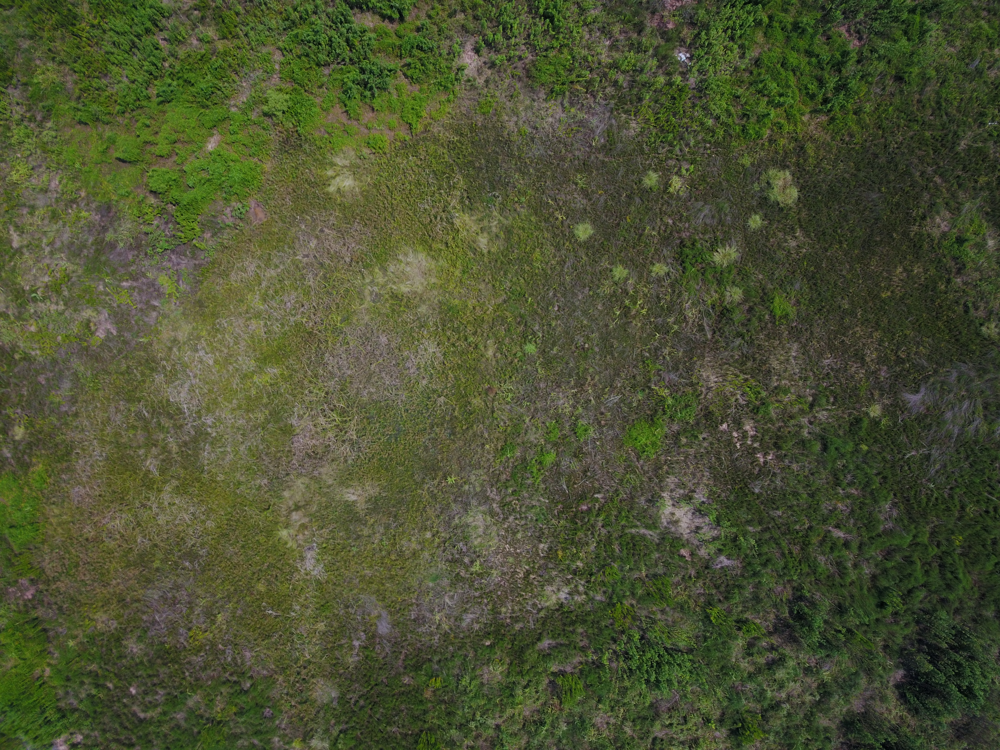

In [ ]:
# fname = "/content/FloodNet Challenge @ EARTHVISION 2021 - Track 1/Train/Labeled/Flooded/image/10165.jpg"
fname = "/content/drive/MyDrive/FloodNet Challenge @ EARTHVISION 2021 - Track 1/Validation/image/8058.jpg"
classes = {0:'Not-Flooded', 1:'Flooded'}
test_img = io.imread(fname)
test_img = cv2.resize(test_img, RESIZE)
test_img = transforms['valid'](test_img).unsqueeze(0)
print(classes[torch.argmax(model(test_img.to(device))).detach().cpu().item()])
Image(filename=fname, height=RESIZE[1], width=RESIZE[0])

# Supervised train loop

In [ ]:
model = torchvision.models.resnet18(pretrained=True)
final_layer_in = model.fc.in_features
model.fc = torch.nn.Linear(final_layer_in, 2)

checkpt = torch.load('/content/drive/MyDrive/checkpoints/fn_0.01_130_11_18_17_best.pt', map_location=device)
model.load_state_dict(checkpt['model_state_dict'])
model = model.to(device)
optimizer = torch.optim.SGD(model.parameters(), lr=0.01)
optimizer.load_state_dict(checkpt['optimizer_state_dict'])
criterion = torch.nn.CrossEntropyLoss()

In [ ]:
def train(model, criterion, optimizer, num_epochs, scheduler=None):
  writer = SummaryWriter()

  since = time.time()

  best_model_wts = copy.deepcopy(model.state_dict())
  best_acc = 0.0

  for epoch in range(num_epochs):

    for phase in ['train', 'valid']:
      if phase == 'train':
        model.train()
      else:
        model.eval()

      running_loss = 0.0
      running_corrects = 0

      # for confusion matrix
      epoch_preds = []
      epoch_lbls = []

      for img, lbl in tqdm(dataloaders[phase], desc=f"Epoch {epoch+1}/{num_epochs}", disable=(phase=='valid')):
        img = img.to(device)
        lbl = lbl.to(device)

        optimizer.zero_grad()

        with torch.set_grad_enabled(phase == 'train'):
          output = model(img)
          preds = torch.argmax(output, 1)
          loss = criterion(output, lbl)

          epoch_preds.extend(preds.detach().cpu())
          epoch_lbls.extend(lbl.detach().cpu())

          if phase == 'train':
            loss.backward()
            optimizer.step()

        running_loss += loss.item() * img.size(0)
        running_corrects += torch.sum(preds == lbl.data)

      print(f1_score(epoch_lbls, epoch_preds))
      
      if scheduler is not None and phase == 'train':
        scheduler.step()

      epoch_loss = running_loss / dataset_size[phase]
      epoch_acc = running_corrects.double() / dataset_size[phase]

      writer.add_scalar(f'Loss/{phase}', epoch_loss, epoch)
      writer.add_scalar(f'Accuracy/{phase}', epoch_acc, epoch)

      print(f'Epoch {epoch+1}, {phase} Loss: {epoch_loss:.4f}, Acc:{epoch_acc:.4f}')

      # GENERATE RESULTS
      if phase == 'valid':
        json_data = {}
        for img, lbl in tqdm(dataloaders['validation_dataset'], desc="Calculating result"):
          img = img.to(device)
          preds = torch.argmax(model(img),1)
          fnames = list(map(lambda x: os.path.splitext(os.path.split(validation_file_names[x])[1])[0], lbl))
          # save in json
          preds = preds.detach().tolist()
          preds = list(map(lambda x: x^1, preds)) # this is to invert 1s to 0s and 0s to 1s
          json_data.update(dict(zip(fnames, preds)))
        with open(f'image_classes_{epoch}.json', 'w') as f:
            json.dump(json_data, f)

      if phase == 'valid' and epoch_acc > best_acc:
        best_acc = epoch_acc
        best_model_wts = copy.deepcopy(model.state_dict())
  
  time_elapsed = time.time() - since
  writer.close()
  print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
  model.load_state_dict(best_model_wts)
  return model

In [ ]:
train(model, criterion, optimizer, 5)


0.9462365591397849
Epoch 1, train Loss: 0.3903, Acc:0.9497
0.9361702127659575
Epoch 1, valid Loss: 0.0495, Acc:0.9849



0.9870801033591732
Epoch 2, train Loss: 0.0454, Acc:0.9874
0.7619047619047621
Epoch 2, valid Loss: 0.1460, Acc:0.9497



0.9848484848484848
Epoch 3, train Loss: 0.0312, Acc:0.9849
0.9361702127659575
Epoch 3, valid Loss: 0.0276, Acc:0.9849



0.9944444444444445
Epoch 4, train Loss: 0.0180, Acc:0.9950
0.9795918367346939
Epoch 4, valid Loss: 0.0101, Acc:0.9950



0.9974554707379135
Epoch 5, train Loss: 0.0132, Acc:0.9975
1.0
Epoch 5, valid Loss: 0.0050, Acc:1.0000



Training complete in 0m 52s


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  